Christian Knowles V00874629

In [1]:
%matplotlib inline 
import numpy as np
import librosa as lb
import IPython.display as ipd
import matplotlib.pyplot as plt

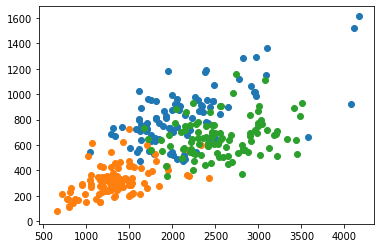

In [53]:
#Question 1 Part 1: Spectral Centroid of dataset
import glob
reggaeFiles = glob.glob('reggae/*.wav')
classicalFiles = glob.glob('classical/*.wav')
discoFiles = glob.glob('disco/*.wav')

files = np.asarray(reggaeFiles)

meanReggae = []
stdReggae = []
for x in files:
    data, sr = lb.load(x)
    centroid = lb.feature.spectral_centroid(y=data, sr=sr)
    centroid_mean = np.mean(centroid)
    centroid_std = np.std(centroid)
    meanReggae.append(centroid_mean)
    stdReggae.append(centroid_std)
plt.scatter(meanReggae, stdReggae)

files = np.asarray(classicalFiles)

meanClassical = []
stdClassical = []
for x in files:
    data, sr = lb.load(x)
    centroid = lb.feature.spectral_centroid(y=data, sr=sr)
    centroid_mean = np.mean(centroid)
    centroid_std = np.std(centroid)
    meanClassical.append(centroid_mean)
    stdClassical.append(centroid_std)
plt.scatter(meanClassical, stdClassical)

files = np.asarray(discoFiles)

meanDisco = []
stdDisco = []
for x in files:
    data, sr = lb.load(x)
    centroid = lb.feature.spectral_centroid(y=data, sr=sr)
    centroid_mean = np.mean(centroid)
    centroid_std = np.std(centroid)
    meanDisco.append(centroid_mean)
    stdDisco.append(centroid_std)
plt.scatter(meanDisco, stdDisco)

X Axis is mean, Y axis is standard deviation

Classical = ORANGE

Reggae = BLUE

Disco = GREEN

The reggae and disco tracks have quite a lot of overlap, but the classical tracks are much less interwoven with the other data, which indicates that reggae and disco share similar sonic characteristics (based on the dataset).  The classical music has low centroid mean and std indicating a lower-end spectrum.  The other two genres are much brighter overall (higher mean) and more varied in spectrum (greater standard deviation)

In [142]:
#Question 1 Part 2: Cross validation
from sklearn.model_selection import cross_val_predict
from sklearn.model_selection import cross_validate
from sklearn.metrics import confusion_matrix
from sklearn import svm
from sklearn.naive_bayes import GaussianNB
import random

#Prep data for training

#for targets we'll have reggae be 0, disco be 1, and classical be 2
reggaeTargets = np.zeros(len(reggae))
discoTargets = np.ones(len(disco))
classicalTargets = np.full(len(classical), 2)

meanValues = np.concatenate((meanDisco, meanReggae, meanClassical))
stdValues = np.concatenate((stdDisco, stdReggae, stdClassical))
targets = np.concatenate((discoTargets, reggaeTargets, classicalTargets))

#shuffle values for each set of data
data = list(zip(meanValues, targets))
random.shuffle(data)
meanValues, meanTargets = zip(*data)
meanValues = np.array([ [x] for x in meanValues])
meanTargets = np.array(meanTargets)
data = list(zip(stdValues, targets))
random.shuffle(data)
stdValues, stdTargets = zip(*data)
stdValues = np.array([ [x] for x in stdValues])
stdTargets = np.array(stdTargets)

print('MEAN:')
print()

linear_clf = svm.SVC(gamma='scale')
predicted_values = cross_val_predict(linear_clf, meanValues, meanTargets, cv=10)
true_values = meanTargets
cf = confusion_matrix(predicted_values, meanTargets)
cv = cross_validate(linear_clf, meanValues, meanTargets, cv=10)
avg_score = np.mean(cv['test_score'])
print('Using linear support vector machine')
print('average score:', avg_score)
print("Confusion Matrix: Disco, Reggae, Classical")
print(cf)
print()

gnb = GaussianNB()
predicted_values = cross_val_predict(gnb, meanValues, meanTargets, cv=10)
true_values = meanTargets
cf = confusion_matrix(predicted_values, meanTargets)
cv = cross_validate(gnb, meanValues, meanTargets, cv=10)
avg_score = np.mean(cv['test_score'])
print('Using naive bayes classified trainer')
print('average score:', avg_score)
print("Confusion Matrix: Disco, Reggae, Classical")
print(cf)
print()

MEAN:

Using linear support vector machine
average score: 0.6866666666666666
Confusion Matrix: Disco, Reggae, Classical
[[54 36  8]
 [41 60  0]
 [ 5  4 92]]

Using naive bayes classified trainer
average score: 0.6799999999999999
Confusion Matrix: Disco, Reggae, Classical
[[35 19  5]
 [61 77  3]
 [ 4  4 92]]



In [144]:
#Now let's do the same thing but with standard deviation
print('STANDARD DEVIATION:')
print()

linear_clf = svm.SVC(gamma='scale')
predicted_values = cross_val_predict(linear_clf, stdValues, stdTargets, cv=10)
true_values = stdTargets
cf = confusion_matrix(predicted_values, stdTargets)
cv = cross_validate(linear_clf, stdValues, stdTargets, cv=10)
avg_score = np.mean(cv['test_score'])
print('Using linear support vector machine')
print('average score:', avg_score)
print("Confusion Matrix: Disco, Reggae, Classical")
print(cf)
print()

gnb = GaussianNB()
predicted_values = cross_val_predict(gnb, stdValues, stdTargets, cv=10)
true_values = stdTargets
cf = confusion_matrix(predicted_values, stdTargets)
cv = cross_validate(gnb, stdValues, stdTargets, cv=10)
avg_score = np.mean(cv['test_score'])
print('Using naive bayes classified trainer')
print('average score:', avg_score)
print("Confusion Matrix: Disco, Reggae, Classical")
print(cf)
print()

STANDARD DEVIATION:

Using linear support vector machine
average score: 0.7266666666666667
Confusion Matrix: Disco, Reggae, Classical
[[57 17 18]
 [32 82  3]
 [11  1 79]]

Using naive bayes classified trainer
average score: 0.7266666666666667
Confusion Matrix: Disco, Reggae, Classical
[[56 18 16]
 [32 81  3]
 [12  1 81]]



In [65]:
#Question 1 Part 3: Sonificiation of Centroids
data, sr = lb.load(reggaeFiles[69], sr=44100)
centroid = lb.feature.spectral_centroid(y=data, sr=sr)
samples = np.linspace(0, 1, sr)
samples = samples[0:1024]
wav = np.sin(2 * np.pi * 440 * 1) #initial sin wave to append to
for x in np.arange(0,len(centroid[0])):
    wav = np.append(wav, np.sin(2 * np.pi * centroid[0][x] * samples))
result = wav[:len(data)] * 0.25 + data
ipd.Audio(result, rate=44100)

In [39]:
#Sonificiation of Centroids (Classical)
data, sr = lb.load(classicalFiles[69], sr=44100)
centroid = lb.feature.spectral_centroid(y=data, sr=sr)
samples = np.linspace(0, 1, sr)
samples = samples[0:1024]
wav = np.sin(2 * np.pi * 440 * 1) #initial sin wave to append to
for x in np.arange(0,len(centroid[0])):
    wav = np.append(wav, np.sin(2 * np.pi * centroid[0][x] * samples))
result = wav[:len(data)] * 0.25 + data
ipd.Audio(result, rate=44100)

In [40]:
#Sonificiation of Centroids (Disco)
data, sr = lb.load(discoFiles[69], sr=44100)
centroid = lb.feature.spectral_centroid(y=data, sr=sr)
samples = np.linspace(0, 1, sr)
samples = samples[0:1024]
wav = np.sin(2 * np.pi * 440 * 1) #initial sin wave to append to
for x in np.arange(0,len(centroid[0])):
    wav = np.append(wav, np.sin(2 * np.pi * centroid[0][x] * samples))
result = wav[:len(data)] * 0.25 + data
ipd.Audio(result, rate=44100)

The sonifications of the three genres share a similar rhythm to their respective tracks.  The slower-moving sonification sounds like the classical one, and the more energetic sonification sound the closest to the disco.  Let's try three other recordings to see if the listening observation holds

In [44]:
#Reggae track
data, sr = lb.load(reggaeFiles[42], sr=44100)
centroid = lb.feature.spectral_centroid(y=data, sr=sr)
samples = np.linspace(0, 1, sr)
samples = samples[0:1024]
wav = np.sin(2 * np.pi * 440 * 1) #initial sin wave to append to
for x in np.arange(0,len(centroid[0])):
    wav = np.append(wav, np.sin(2 * np.pi * centroid[0][x] * samples))
result = wav[:len(data)] * 0.25 + data
ipd.Audio(result, rate=44100)

In [45]:
#Classical track
data, sr = lb.load(classicalFiles[42], sr=44100)
centroid = lb.feature.spectral_centroid(y=data, sr=sr)
samples = np.linspace(0, 1, sr)
samples = samples[0:1024]
wav = np.sin(2 * np.pi * 440 * 1) #initial sin wave to append to
for x in np.arange(0,len(centroid[0])):
    wav = np.append(wav, np.sin(2 * np.pi * centroid[0][x] * samples))
result = wav[:len(data)] * 0.25 + data
ipd.Audio(result, rate=44100)

In [46]:
#Disco track
data, sr = lb.load(discoFiles[42], sr=44100)
centroid = lb.feature.spectral_centroid(y=data, sr=sr)
samples = np.linspace(0, 1, sr)
samples = samples[0:1024]
wav = np.sin(2 * np.pi * 440 * 1) #initial sin wave to append to
for x in np.arange(0,len(centroid[0])):
    wav = np.append(wav, np.sin(2 * np.pi * centroid[0][x] * samples))
result = wav[:len(data)] * 0.25 + data
ipd.Audio(result, rate=44100)

The sonifications do a good job of capturing rhythmic events like percussive hits (snare especially).  If you know what the original recordings sound like, it's pretty easy to connect the sonification to the original.

In [105]:
#Question 1.4: MFCC
mfcc = lb.feature.mfcc

files = np.asarray(reggaeFiles)

meanReggae = []
stdReggae = []
for x in files:
    data, sr = lb.load(x)
    cepstrum = mfcc(y=data, sr=sr)
    cepstrum_mean = np.mean(cepstrum)
    cepstrum_std = np.std(cepstrum)
    meanReggae.append(cepstrum_mean)
    stdReggae.append(cepstrum_std)

files = np.asarray(classicalFiles)

meanClassical = []
stdClassical = []
for x in files:
    data, sr = lb.load(x)
    cepstrum = mfcc(y=data, sr=sr)
    cepstrum_mean = np.mean(cepstrum)
    cepstrum_std = np.std(cepstrum)
    meanClassical.append(cepstrum_mean)
    stdClassical.append(cepstrum_std)

files = np.asarray(discoFiles)

meanDisco = []
stdDisco = []
for x in files:
    data, sr = lb.load(x)
    cepstrum = mfcc(y=data, sr=sr)
    cepstrum_mean = np.mean(cepstrum)
    cepstrum_std = np.std(cepstrum)
    meanDisco.append(cepstrum_mean)
    stdDisco.append(cepstrum_std)

In [160]:
#We're gonna do the same thing as 1.2 but for mean and mean+std
#Prep data for training

#for targets we'll have reggae be 0, disco be 1, and classical be 2
reggaeTargets = np.zeros(len(reggae))
discoTargets = np.ones(len(disco))
classicalTargets = np.full(len(classical), 2)

meanValues = np.concatenate((meanDisco, meanReggae, meanClassical))
stdValues = np.concatenate((stdDisco, stdReggae, stdClassical))
targets = np.concatenate((discoTargets, reggaeTargets, classicalTargets))

#shuffle values for each set of data
data = list(zip(meanValues, targets))
random.shuffle(data)
meanValues, meanTargets = zip(*data)
meanValues = np.array([ [x] for x in meanValues])
meanTargets = np.array(meanTargets)

combValues = np.column_stack((meanValues, stdValues))
data = list(zip(combValues, targets))
random.shuffle(data)
combValues, combTargets = zip(*data)
combTargets = np.array(combTargets)

print('MEAN:')
print()

predicted_values = cross_val_predict(linear_clf, meanValues, meanTargets, cv=10)
true_values = meanTargets
cf = confusion_matrix(predicted_values, meanTargets)
cv = cross_validate(linear_clf, meanValues, meanTargets, cv=10)
avg_score = np.mean(cv['test_score'])
print('Using linear support vector machine')
print('average score:', avg_score)
print("Confusion Matrix: Disco, Reggae, Classical")
print(cf)
print()

predicted_values = cross_val_predict(gnb, meanValues, meanTargets, cv=10)
true_values = meanTargets
cf = confusion_matrix(predicted_values, meanTargets)
cv = cross_validate(gnb, meanValues, meanTargets, cv=10)
avg_score = np.mean(cv['test_score'])
print('Using naive bayes classified trainer')
print('average score:', avg_score)
print("Confusion Matrix: Disco, Reggae, Classical")
print(cf)
print()

MEAN:

Using linear support vector machine
average score: 0.6799999999999999
Confusion Matrix: Disco, Reggae, Classical
[[53 37  8]
 [41 59  0]
 [ 6  4 92]]

Using naive bayes classified trainer
average score: 0.6599999999999999
Confusion Matrix: Disco, Reggae, Classical
[[31 21  5]
 [65 75  3]
 [ 4  4 92]]



In [161]:
#Now let's do the same thing but with standard deviation
print('MEAN+STANDARD DEVIATION:')
print()

predicted_values = cross_val_predict(linear_clf, combValues, combTargets, cv=10)
true_values = combTargets
cf = confusion_matrix(predicted_values, combTargets)
cv = cross_validate(linear_clf, combValues, combTargets, cv=10)
avg_score = np.mean(cv['test_score'])
print('Using linear support vector machine')
print('average score:', avg_score)
print("Confusion Matrix: Disco, Reggae, Classical")
print(cf)
print()

predicted_values = cross_val_predict(gnb, combValues, combTargets, cv=10)
true_values = combTargets
cf = confusion_matrix(predicted_values, combTargets)
cv = cross_validate(gnb, combValues, combTargets, cv=10)
avg_score = np.mean(cv['test_score'])
print('Using naive bayes classified trainer')
print('average score:', avg_score)
print("Confusion Matrix: Disco, Reggae, Classical")
print(cf)
print()

MEAN+STANDARD DEVIATION:

Using linear support vector machine
average score: 0.7166666666666666
Confusion Matrix: Disco, Reggae, Classical
[[61 26 16]
 [29 73  3]
 [10  1 81]]

Using naive bayes classified trainer
average score: 0.7333333333333333
Confusion Matrix: Disco, Reggae, Classical
[[58 18 16]
 [31 81  3]
 [11  1 81]]



In [136]:
#Question 1.5 (TODO)

In [184]:
#Question 2.1: Predictive lyrics
import pickle

#load .pck files
with open('csc475_asn4_data/dictionary.pck', 'rb') as f:
    u = pickle._Unpickler(f)
    u.encoding = 'latin1'
    dictionary = u.load()
with open('csc475_asn4_data/tracks.pck', 'rb') as f:
    u = pickle._Unpickler(f)
    u.encoding = 'latin1'
    tracks = u.load()

#load .npz files
documents = np.load('csc475_asn4_data/data.npz')
documents = documents.f.arr_0
labels = np.load('csc475_asn4_data/labels.npz')
labels = labels.f.arr_0
words = np.load('csc475_asn4_data/words.npz')
words = words.f.arr_0

bestWords = [dictionary[i] for i in words]
vocab = np.arange(0,len(bestWords))
genreLabels = [1, 3, 12]

# binarize data
for d in documents:
    d[d > 0] = 1

In [197]:
# Make predictive model
from sklearn.naive_bayes import BernoulliNB

def predictor(genres, docs, labels, vocab):
    vocabLen = len(vocab)
    docLen = len(docs)
    probability = np.zeros(shape=(vocabLen,genres[-1]+1))
    for g in genres:
        genreLen = len([x for x in labels if x == g])
        for term in vocab:
            docsWClass = [doc for i, doc in enumerate(docs) if labels[i] == g]
            docsWTerm = [doc for doc in docsWClass if doc[term] == 1]
            MatchingLen = len(docsWTerm)
            probability[term][g] = (MatchingLen+1)/(genreLen+2)
    return probability

probability = predictor(genreLabels, documents, labels, vocab)

print(probability)

[[0.         0.03792415 0.         0.00698603 0.         0.
  0.         0.         0.         0.         0.         0.
  0.08782435]
 [0.         0.00698603 0.         0.00399202 0.         0.
  0.         0.         0.         0.         0.         0.
  0.18562874]
 [0.         0.04590818 0.         0.05189621 0.         0.
  0.         0.         0.         0.         0.         0.
  0.43912176]
 [0.         0.03193613 0.         0.000998   0.         0.
  0.         0.         0.         0.         0.         0.
  0.06287425]
 [0.         0.00698603 0.         0.01996008 0.         0.
  0.         0.         0.         0.         0.         0.
  0.28243513]
 [0.         0.02694611 0.         0.000998   0.         0.
  0.         0.         0.         0.         0.         0.
  0.05788423]
 [0.         0.08782435 0.         0.00898204 0.         0.
  0.         0.         0.         0.         0.         0.
  0.41217565]
 [0.         0.04091816 0.         0.01197605 0.         0.
  

In [50]:
#Question 2.2 (TODO)

In [51]:
#Question 2.3 (TODO)

In [52]:
#Question 2.4 (TODO)

In [ ]:
#Question 2.5 (TODO)